In [1]:

import os
import json
import random
from tqdm import tqdm
import numpy as np
import einops
from transformers import (
    GenerationConfig,
)
import torch
import torch.nn.functional as F
from fancy_einsum import einsum
import einops
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots

from src.record_utils import record_activations, get_module
from src.HookedQwen import convert_to_hooked_model
from src.utils import seed_all, load_model, get_dataloader

In [2]:

cos = F.cosine_similarity

In [3]:

config = {
    "data_path": "data/train.parquet",
    "model_path": "checkpoints/TinyZero/v4/actor/global_step_300",
    "batch_size": 4,
    "valid_size": 256,
    "max_prompt_length": 256,
    "max_response_length": 300,
    "n_layers": 36,
    "d_model": 2048,
    "seed": 42,
}

seed_all(config["seed"])

In [4]:

actor = load_model(config["model_path"])
generation_config = GenerationConfig(do_sample=False)
tokenizer = actor.tokenizer

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

In [19]:

convert_to_hooked_model(actor)

In [6]:

_, valid_dataloader = get_dataloader(
    config["data_path"],
    config["batch_size"],
    config["max_prompt_length"],
    config["valid_size"],
    actor.tokenizer,
)

original dataset len: 327680
filter dataset len: 327680


In [7]:

probe_path = "probe_checkpoints/probe_attn_per_head_last_int/probe.pt"
probes = torch.load(probe_path).detach()
print(probes.shape)

torch.Size([36, 16, 2048, 2])


/tmp/ipykernel_3495805/896184948.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  probes = torch.load(probe_path).detach()


In [8]:

n_layers = probes.shape[0]
n_heads = probes.shape[1]
d_model = probes.shape[2]

pos_probes = probes[..., 1]
neg_probes = probes[..., 0]

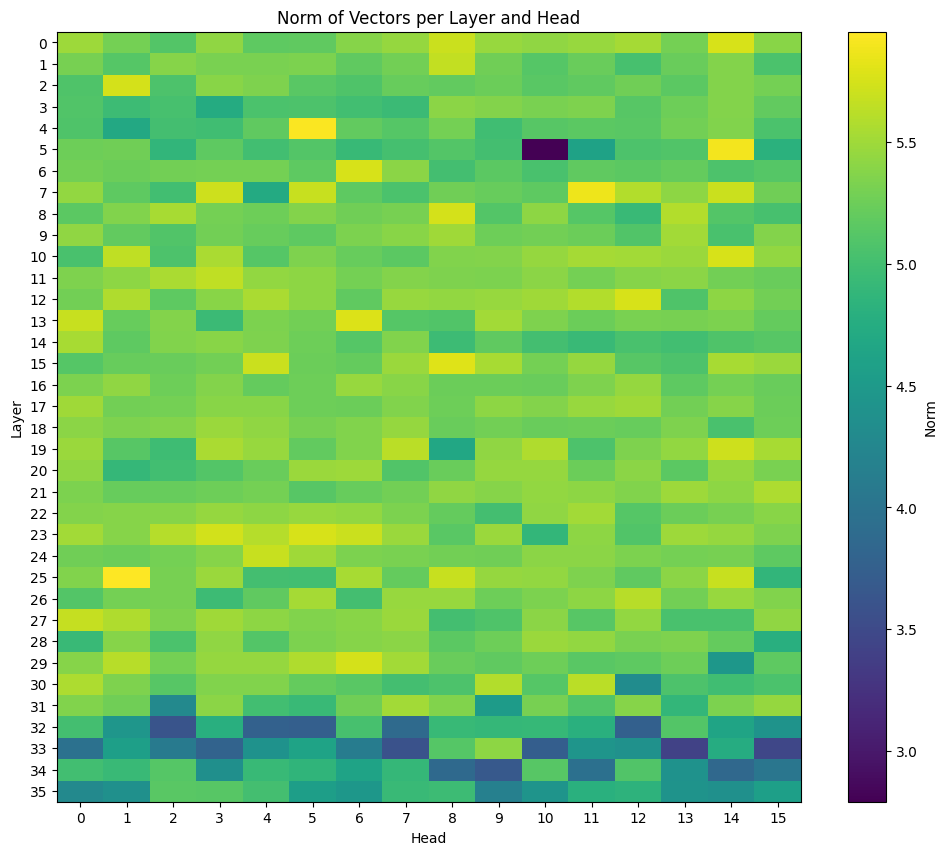

In [9]:

norms = torch.norm(pos_probes, dim=-1)  # Shape: [Layers, num_heads]
# Plot the heatmap
plt.figure(figsize=(12, 10))
plt.imshow(norms.cpu().numpy(), cmap="viridis", aspect="auto")
plt.colorbar(label="Norm")
plt.xlabel("Head")
plt.ylabel("Layer")
plt.title("Norm of Vectors per Layer and Head")
plt.xticks(range(n_heads))
plt.yticks(range(n_layers))
plt.show()

In [12]:

token_this = tokenizer.encode("this")[0]  # 574
token_open = tokenizer.encode(" (")[0]  # 320
token_not = tokenizer.encode("not")[0]  # 1921

In [14]:


def get_samples(actor, valid_dataloader, sample_size=1):
    max_new_tokens = 300
    timestep_offset = 1
    samples = []
    for batch_idx, batch in enumerate(valid_dataloader):

        input_ids = batch["input_ids"].cuda()
        attention_mask = batch["attention_mask"].cuda()
        output = actor.generate(
            input_ids=input_ids,
            attention_mask=attention_mask,
            max_new_tokens=max_new_tokens,
            eos_token_id=tokenizer.eos_token_id,
            pad_token_id=tokenizer.pad_token_id,
            generation_config=generation_config,
            output_scores=False,  # this is potentially very large
            return_dict_in_generate=True,
            use_cache=True,
        )  # may OOM when use_cache = True

        # [batch, prompt_length + max_new_tokens, d_model]
        response = output.sequences
        response_text = tokenizer.batch_decode(response, skip_special_tokens=True)

        mask_not = (response[:, :-1] == token_open) & (response[:, 1:] == token_not)
        mask_this = (response[:, :-1] == token_open) & (response[:, 1:] == token_this)
        batch_idx_not, timesteps_not = torch.where(mask_not)
        batch_idx_this, timesteps_this = torch.where(mask_this)

        batch_idx_not = batch_idx_not
        batch_idx_this = batch_idx_this

        overlap_batches = torch.tensor(
            sorted(
                list(
                    set(batch_idx_not.tolist()).intersection(
                        set(batch_idx_this.tolist())
                    )
                )
            )
        ).cuda()
        batch_mask_not = torch.isin(batch_idx_not, overlap_batches)
        batch_mask_this = torch.isin(batch_idx_this, overlap_batches)

        filtered_timesteps_not = {
            b_idx: timesteps_not[(batch_idx_not == b_idx)]
            for b_idx in overlap_batches.tolist()
        }
        filtered_timesteps_this = {
            b_idx: timesteps_this[(batch_idx_this == b_idx)]
            for b_idx in overlap_batches.tolist()
        }

        for b_idx in filtered_timesteps_this.keys():
            print("Found a match...")
            _this_timesteps = filtered_timesteps_this[b_idx]
            samples.append(
                {
                    "input_ids": input_ids[b_idx],
                    "attention_mask": attention_mask[b_idx],
                    "not_timesteps": filtered_timesteps_not[b_idx],
                    "this_timesteps": _this_timesteps,
                    "prompt": tokenizer.batch_decode(
                        input_ids[b_idx], skip_special_tokens=True
                    ),
                    "output": output.sequences[b_idx],
                }
            )

        if len(samples) >= sample_size:
            break

    return samples

In [15]:

samples = get_samples(actor, valid_dataloader, sample_size=1)

Found a match...


LookupError: model.layers.0.self_attn.hook_attn_out_per_head

In [21]:

record_module_names = [
    f"model.layers.{idx}.self_attn.hook_attn_out_per_head" for idx in range(n_layers)
]

max_new_tokens = 300
with record_activations(actor, record_module_names) as recording:
    output = actor.generate(
        input_ids=samples[0]["input_ids"].unsqueeze(0),
        attention_mask=samples[0]["attention_mask"].unsqueeze(0),
        max_new_tokens=max_new_tokens,
        eos_token_id=tokenizer.eos_token_id,
        pad_token_id=tokenizer.pad_token_id,
        generation_config=generation_config,
        output_scores=False,  # this is potentially very large
        return_dict_in_generate=True,
        use_cache=True,
    )  # may OOM when use_cache = True

TypeError: argument 'ids': 'list' object cannot be interpreted as an integer

In [34]:

response = output.sequences[:, -max_new_tokens:]
response_text = tokenizer.batch_decode(response, skip_special_tokens=True)
print(response_text)

["A conversation between User and Assistant. The user asks a question, and the Assistant solves it. The assistant first thinks about the reasoning process in the mind and then provides the user with the answer.\nUser: Using the numbers [11, 5, 68], create an equation that equals 62. You can use basic arithmetic operations (+, -, *, /) and each number can only be used once. Show your work in <think> </think> tags. And return the final answer in <answer> </answer> tags, for example <answer> (1 + 2) / 3 </answer>.\nAssistant: Let me solve this step by step.\n<think> We have the numbers 11, 5, and 68. We need to use these numbers to make an equation that equals 62 using basic arithmetic operations. Let's try different combinations:\n- 68 - 11 - 5 = 52 - 5 = 47 (not 62)\n- 68 - 11 + 5 = 57 + 5 = 62 (this works)\nSo, the equation that equals 62 is 68 - 11 + 5.\n</think>\n<answer> (68 - 11) + 5 </answer>"]


In [36]:

num_timesteps = response.shape[1]
proj_norms = torch.zeros(n_layers, n_heads, num_timesteps)
print(f"proj_norm shape: {proj_norms.shape}")
for layer_idx in range(n_layers):

    # [batch, seq, heads, d_model]
    attn_out = torch.cat(
        recording[f"model.layers.{layer_idx}.self_attn.hook_attn_out_per_head"],
        dim=1,
    )
    attn_out = attn_out[:, -max_new_tokens:, ...]

    for h_idx in range(n_heads):
        _attn_out = attn_out[0, :, h_idx, :]
        curr_probe = probes[layer_idx, h_idx, :, 1]

        dots = einsum("seq d_model, d_model -> seq", _attn_out, curr_probe)
        proj = dots / torch.norm(curr_probe)
        proj_norms[layer_idx, h_idx] = proj

proj_norm shape: torch.Size([36, 16, 300])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 2048])
torch.Size([1, 300, 16, 204

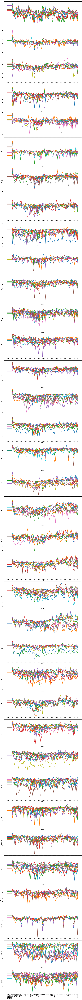

In [42]:

tokens = tokenizer.batch_decode(response[0])
proj_norm_np = proj_norms.numpy()
# Create a subplot per layer. Each subplot will have 'n_heads' curves.
fig, axes = plt.subplots(n_layers, 1, figsize=(18, 6 * n_layers), sharex=True)
if n_layers == 1:
    axes = [axes]  # Ensure axes is always a list for consistency

for l in range(n_layers):
    ax = axes[l]
    for h in range(n_heads):
        ax.plot(range(num_timesteps), proj_norm_np[l, h, :], label=f"Head {h}")
    ax.set_ylabel("Projection Norm")
    ax.set_title(f"Layer {l}")
    #ax.legend(loc="upper right")
    ax.set_xticks(range(num_timesteps))
    ax.set_xticklabels(tokens, rotation=90, ha="right")

axes[-1].set_xlabel("Timestep")
plt.tight_layout()
plt.show()